# Examples of Augmenters

In this notebook, we demonstrate every augmenter by applying it to a batch of synthetic multivariate time series and to a 2-channel audio sequence. 

In [1]:
import numpy as np

import librosa
from IPython.display import Audio

import tsaug
from tsaug.visualization import plot

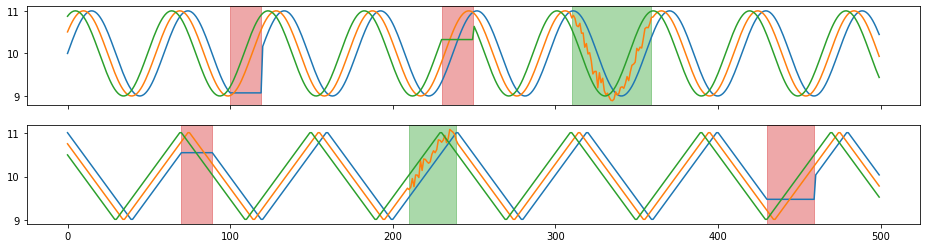

In [2]:
X = np.load("./X.npy")
Y = np.load("./Y.npy")

plot(X, Y);

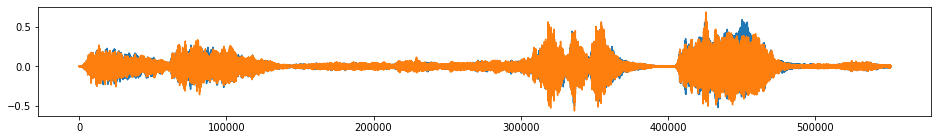

In [3]:
beethoven, samplerate = librosa.load("./beethoven.wav", mono=False)
beethoven = np.expand_dims(beethoven.swapaxes(0,1), 0) # reshape the numpy array to input of tsaug

plot(beethoven);

Audio(beethoven.reshape(-1, 2).T, rate=samplerate)

## tsaug.AddNoise

Add random noise to time series.

The noise added to every time point of a time series is independent and identically distributed.

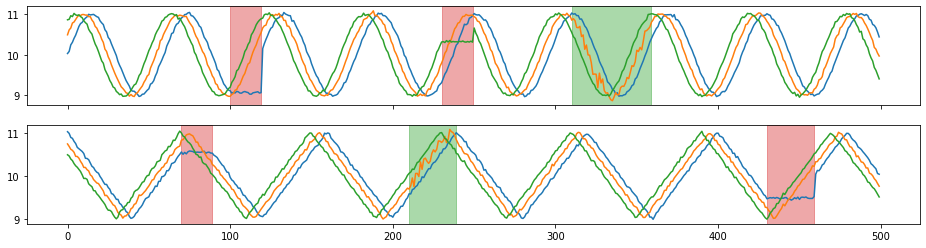

In [4]:
X_aug, Y_aug = tsaug.AddNoise(scale=0.01).augment(X, Y)

plot(X_aug, Y_aug);

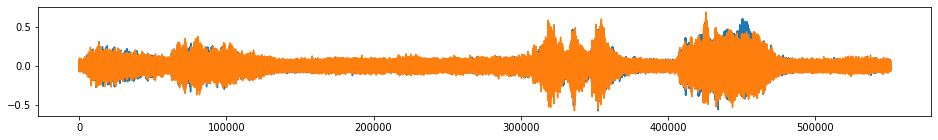

In [5]:
beethoven_aug = tsaug.AddNoise(scale=0.02).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.Convolve

Convolve time series with a kernel window.

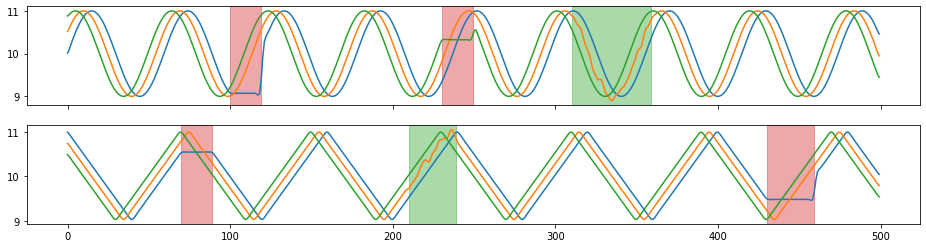

In [6]:
X_aug, Y_aug = tsaug.Convolve(window="flattop", size=11).augment(X, Y)

plot(X_aug, Y_aug);

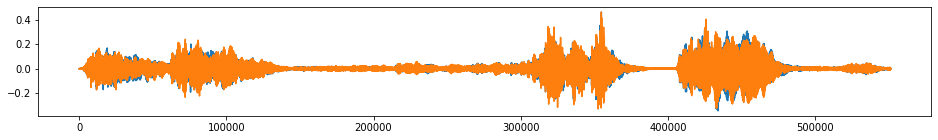

In [7]:
beethoven_aug = tsaug.Convolve(window="hann", size=51).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.Crop

Crop random sub-sequences from time series.

To guarantee all output series have the same length, if the crop size is not deterministic, all crops must be resize to a fixed length.

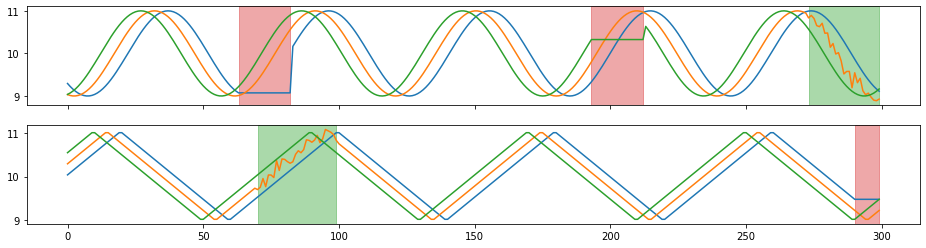

In [8]:
X_aug, Y_aug = tsaug.Crop(size=300).augment(X, Y)

plot(X_aug, Y_aug);

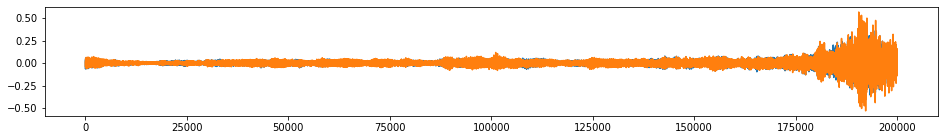

In [9]:
beethoven_aug = tsaug.Crop(size=200000).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.Drift

Drift the value of time series.

The augmenter drifts the value of time series from its original values randomly and smoothly. The extent of drifting is controlled by the maximal drift and the number of drift points.

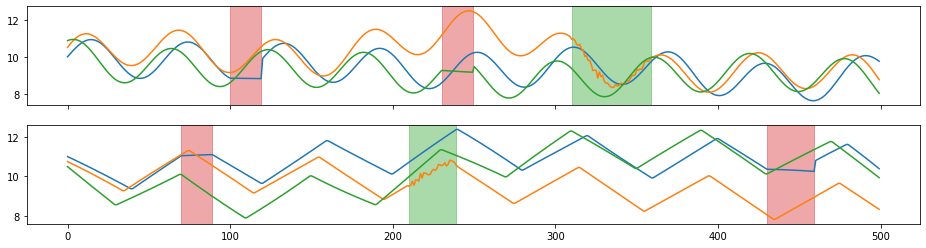

In [10]:
X_aug, Y_aug = tsaug.Drift(max_drift=0.7, n_drift_points=5).augment(X, Y)

plot(X_aug, Y_aug);

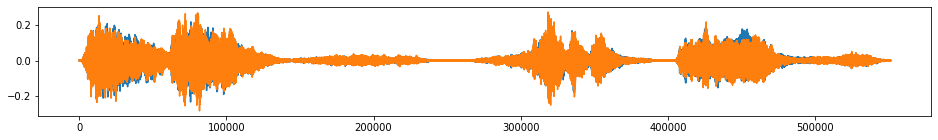

In [11]:
beethoven_aug = tsaug.Drift(max_drift=0.99, n_drift_points=10, kind="multiplicative", per_channel=False).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

 ## tsaug.Dropout

Dropout values of some random time points in time series.

Single time points or sub-sequences could be dropped out.

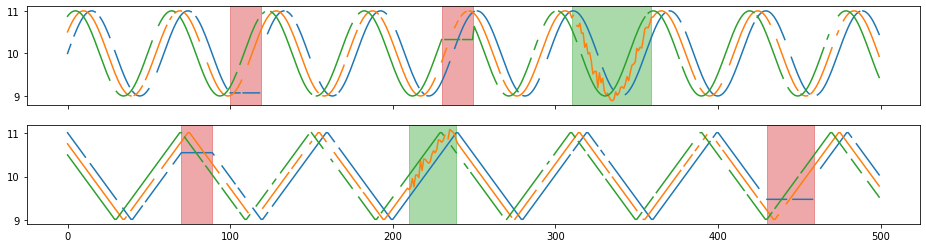

In [12]:
X_aug, Y_aug = tsaug.Dropout(p=0.1, size=(1,5), fill=float("nan"), per_channel=True).augment(X, Y)

plot(X_aug, Y_aug);

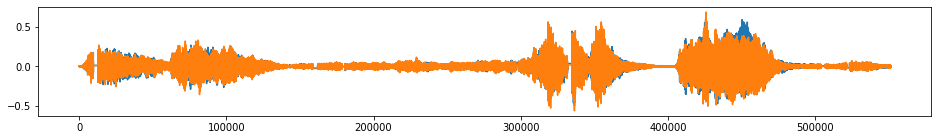

In [13]:
beethoven_aug = tsaug.Dropout(p=0.1, size=[500, 1000, 2000, 3000]).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.Pool

Reduce the temporal resolution without changing the length.

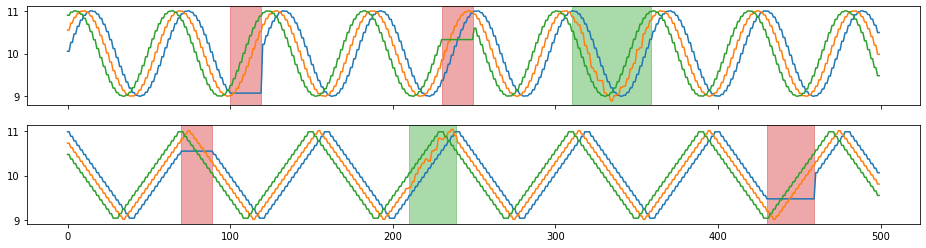

In [14]:
X_aug, Y_aug = tsaug.Pool(size=2).augment(X, Y)

plot(X_aug, Y_aug);

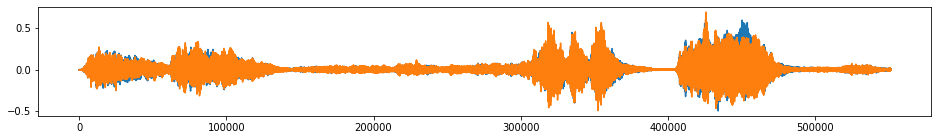

In [15]:
beethoven_aug = tsaug.Pool(kind='max',size=4).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.Quantize

Quantize time series to a level set.

Values in a time series are rounded to the nearest level in the level set.

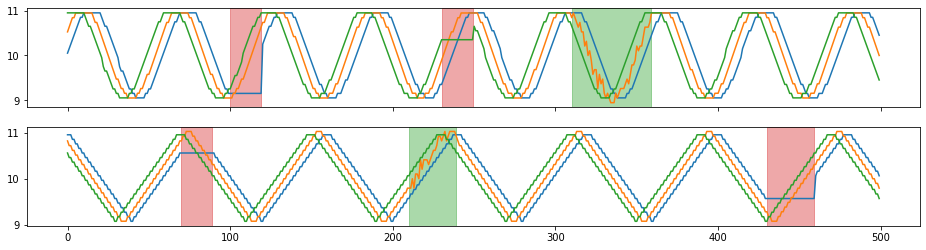

In [16]:
X_aug, Y_aug = tsaug.Quantize(n_levels=20).augment(X, Y)

plot(X_aug, Y_aug);

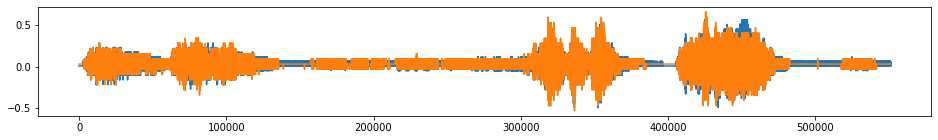

In [17]:
beethoven_aug = tsaug.Quantize(n_levels=20).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.Resize

Change the temporal resolution of time series.

The resized time series is obtained by linear interpolation of the original time series.

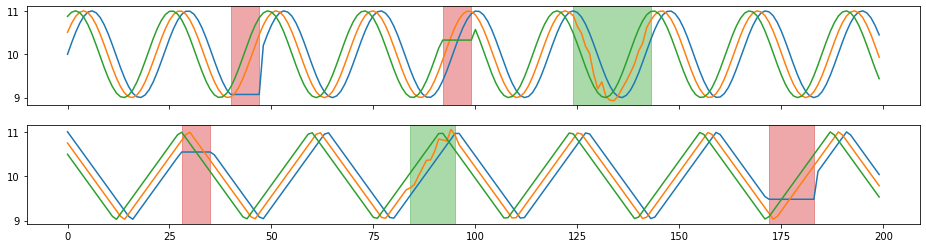

In [18]:
X_aug, Y_aug = tsaug.Resize(size=200).augment(X, Y)

plot(X_aug, Y_aug);

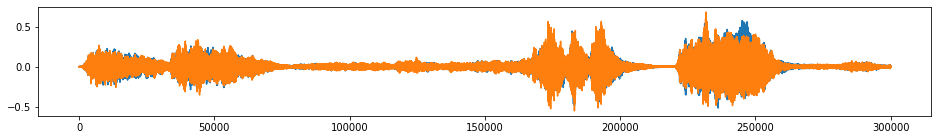

In [19]:
beethoven_aug = tsaug.Resize(size=300000).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.Reverse

Reverse the time line of series.

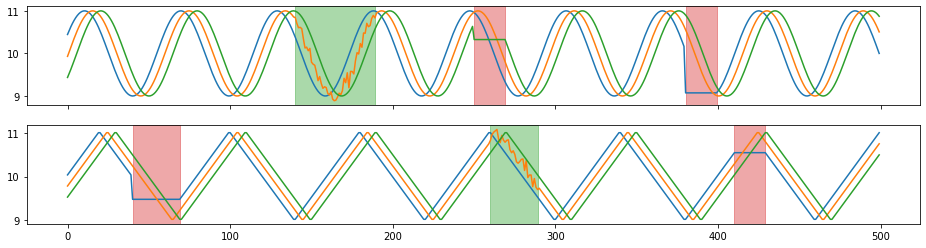

In [20]:
X_aug, Y_aug = tsaug.Reverse().augment(X, Y)

plot(X_aug, Y_aug);

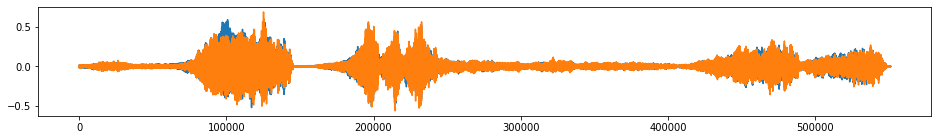

In [21]:
beethoven_aug = tsaug.Reverse().augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)

## tsaug.TimeWarp

Random time warping.

The augmenter random changed the speed of timeline. The time warping is controlled by the number of speed changes and the maximal ratio of max/min speed.

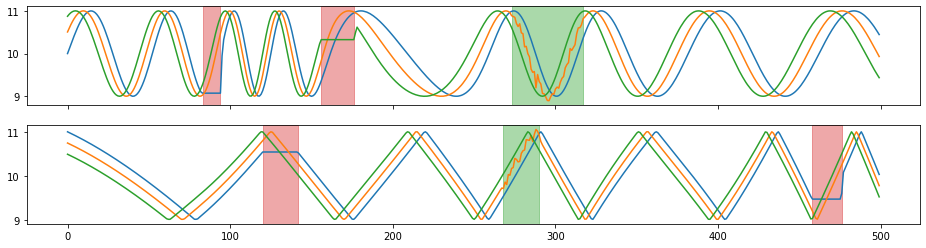

In [22]:
X_aug, Y_aug = tsaug.TimeWarp(n_speed_change=5, max_speed_ratio=3).augment(X, Y)

plot(X_aug, Y_aug);

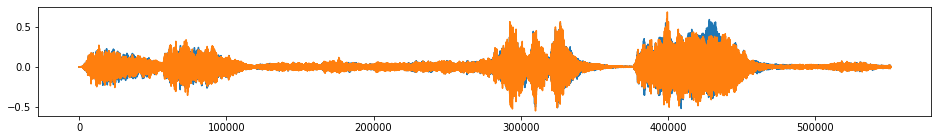

In [23]:
beethoven_aug = tsaug.TimeWarp(n_speed_change=5, max_speed_ratio=2).augment(beethoven)

plot(beethoven_aug);

Audio(beethoven_aug.reshape(-1, 2).T, rate=samplerate)